In [1]:
import sys
import config
sys.path.append(config.root)
import geopandas as gpd
import glob
from shapely.geometry import MultiPolygon,box
import matplotlib.pyplot as plt
import rasterio as rio
from matplotlib import cm
import dask.dataframe as dd
from utils.tiff_io import readTiff
from rasterio import plot   #!!neccessary for the use of rio.plot.plotting_extent
from utils.imgShow import imgShow
from utils.atl06beam_to_dict import atl06beam_to_dict


In [2]:
####-----------rgi shp subseting-----------####
# path_rgi13 = config.root +'/data/rgi/13_rgi60_CentralAsia/13_rgi60_CentralAsia.shp'
# geodf_rgi13 = gpd.read_file(path_rgi13)
# geodf_rgi13_sel = geodf_rgi13[geodf_rgi13['O2Region'] == '5']
# path_save = config.root +'/data/rgi/13_rgi60_CentralAsia/13_05_rgi60.shp'
# geodf_rgi13_sel.to_file(path_save)


In [3]:
path_tibet = config.root +'/data/tibet-plateau-boundary/TPBoundary_HF/TPBoundary_HF.shp'
path_rgi13_05 = config.root +'/data/rgi/13_rgi60_CentralAsia/13_05_rgi60.shp'
path_dem = config.root+'/data/dem/rgi13_05_SRTMGL3_shaded.tif'
path_img = config.root + '/data/rs_img/S3A_20191225T045036_20191225T045336.tif'
path_icesat2 = data_root= config.root + '/data/icesat2/atl06_kunlun'


In [4]:
geodf_tibet = gpd.read_file(path_tibet)
geodf_rgi13_05 = gpd.read_file(path_rgi13_05)
geodf_tibet_wgs84 = geodf_tibet.to_crs("EPSG:4326")   # re-projection
s3_img_src, s3_img = readTiff(path_img)
# height_alt06 = dd.read_csv(alt06_dir+'/*.csv')
# convert dask.dataframe to np.array
# height_array = height_alt06.values.compute() 


In [5]:
## region bounds
polygons = [ p for p in geodf_rgi13_05['geometry']]
multipolygon = MultiPolygon(polygons)
bounds = multipolygon.bounds
print(bounds)
bounds_points = [(bounds[0],bounds[1]), (bounds[2],bounds[1]),(bounds[2],bounds[3]),(bounds[0],bounds[3]),(bounds[0],bounds[1])]
bounds_points_x, bounds_points_y = zip(*bounds_points)

(76.37582141800004, 34.41479521900004, 83.27251984100008, 37.28004035500004)


### RGI data visualization

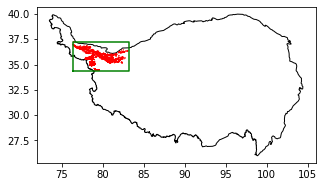

In [6]:
geodf_tibet_wgs84 = geodf_tibet.to_crs("EPSG:4326")   # re-projection
fig, ax = plt.subplots(1, 1, figsize=(5,3))
geodf_tibet_wgs84.plot(ax=ax, color='white', edgecolor='black')
# geodf_rgi13.plot(ax=ax, color='white', edgecolor='green')
geodf_rgi13_05.plot(ax=ax, color='white', edgecolor='red')
ax.plot(bounds_points_x, bounds_points_y, color='green')


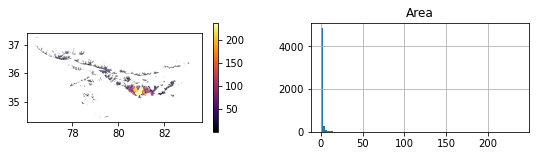

In [7]:
fig, ax = plt.subplots(1, 2, figsize=(9,2))
geodf_rgi13_05.plot('Area', ax=ax[0], markersize=1,\
                    cmap='inferno', legend=True);
hist = geodf_rgi13_05.hist(ax=ax[1], column='Area', bins=100)

### DEM data and alt06 track

<AxesSubplot:>

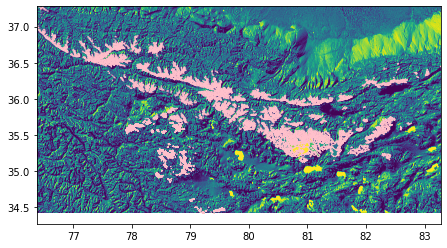

In [8]:
srtm_src = rio.open(path_dem)
srtm_extent = rio.plot.plotting_extent(srtm_src)
srtm = srtm_src.read(1)
f, ax = plt.subplots(figsize=(8,4))
ax.imshow(srtm, extent=srtm_extent)
geodf_rgi13_05.plot('Area', ax=ax, markersize=1, \
                            edgecolor='pink', label='glacier')


### Remote sensing image and alt06 height

In [9]:
## read atl06 data
atl06_files=glob.glob(os.path.join(path_icesat2, 'processed_ATL06*.h5'))
D_dict={}
error_count=0
for file in atl06_files:
    try:
        D_dict[file]=atl06beam_to_dict(file, '/gt2l', index=slice(0, -1, 25), epsg=32644)
    except KeyError as e:
        print(f'file {file} encountered error {e}')
        error_count += 1
print(f"read {len(D_dict)} data files of which {error_count} gave errors")


file /Users/luo/OneDrive/Open-source-project/icesat-tibet/data/icesat2/atl06_kunlun/processed_ATL06_20191108154310_06530502_004_01.h5 encountered error 'Unable to open object (component not found)'
file /Users/luo/OneDrive/Open-source-project/icesat-tibet/data/icesat2/atl06_kunlun/processed_ATL06_20190809200315_06530402_004_01.h5 encountered error 'Unable to open object (component not found)'
read 127 data files of which 2 gave errors


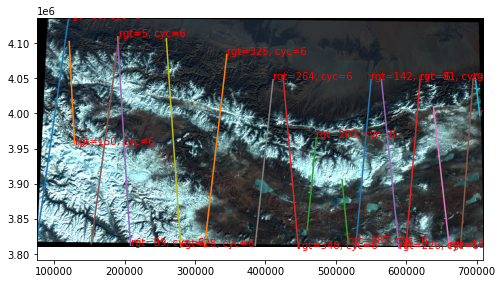

In [20]:
s3_extent = rio.plot.plotting_extent(s3_img_src)

cycle_sel = 6
plt.figure(figsize=[8,8])
ax = plt.subplot(111)
imgShow(s3_img, extent=s3_extent, color_bands=(0, 1, 2), clip_percent=5)

for fname, Di in D_dict.items():    # plot tracks
    cycle=Di['cycle']
    if cycle != cycle_sel:
        continue
    ax.plot(Di['x'], Di['y'])
    ax.text(Di['x'][0], Di['y'][0], f"rgt={Di['rgt']}, cyc={cycle}", color='r', fontsize = 10, clip_on=True)


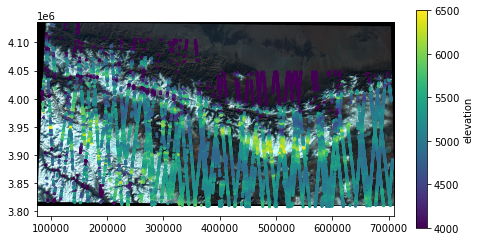

In [12]:
map_fig=plt.figure(figsize=(8,4))

map_ax=map_fig.add_subplot(111)
imgShow(s3_img, extent=s3_extent, color_bands=(0, 1, 2), clip_percent=5)
for fname, Di in D_dict.items():
    # select elevations with good quality_summary
    good=Di['atl06_quality_summary']==0
    ms=map_ax.scatter(Di['x'][good], Di['y'][good], 4, \
                c=Di['h_li'][good], vmin=4000, vmax=6500, label=fname)

plt.colorbar(ms, label='elevation');

